In [1]:
%env TOKENIZERS_PARALLELISM=true
! pip install sentence-transformers

env: TOKENIZERS_PARALLELISM=true
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 2.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... - \ done
  Created wheel for sentence-transformers: filename=sentence_transformers-2.2.2-py3-none-any.whl size=125923 sha256=467df1ec257504b33ee255863a0084c24b075d10284bc1f6f501e98a3dfb5844
  Stored in directory: /root/.cache/pip/wheels/62/f2/10/1e606fd5f02395388f74e7462910fe851042f97238cbbd902f
Successfully built sentence-transformers


In [2]:
import pandas as pd
from plotly.express import bar
from string import punctuation
terms = {
    'python': 'python',
    'ruby': 'ruby',
    'java': 'java',
    'rust': 'rust',
    'swift': 'swift',
    'haskell': 'Haskell',
    'scala' : 'Scala',
    'elixir': 'elixir',
    'julia': 'julia',
    'perl': 'perl',
    'matlab': 'MATLAB',
    'golang': 'go',
    'typescript': 'typescript',
    'js': 'javascript',
    'javascript': 'javascript',
    'sql': 'SQL',
    'php': 'PHP',
    'html': 'HTML',
    'node.js': 'Node',
    'node': 'Node',
    'c++': 'c++',
    'bash': 'Bash',
    'shell': 'shell',
    'r': 'R',
    'c': 'C',
    'c#': 'C#',
    'graphql': 'GraphQL',
    'angular': 'Angular',
    'react': 'React',
    'reactjs': 'React',
    'clojure': 'Clojure',
    'kotlin': 'Kotlin',
    'powershell': 'PowerShell',
    'css': 'CSS',
    'postgresql': 'PostgreSQL',
    'mysql': 'MySQL',
}
def get_language(arg: str) -> str:
    no_punctuation = arg
    for item in set(punctuation):
        no_punctuation = no_punctuation.replace(item, ' ')
    tokens = no_punctuation.lower().split()
    for key, value in terms.items():
        if key in tokens:
            return value
    return 'other'
df = pd.read_csv(filepath_or_buffer='/kaggle/input/alpaca-instructions-word-level-classification/train.csv')
df['token count'] = df['instruction'].apply(func=lambda x: len(x.split()))
df['language'] = df['instruction'].apply(func=get_language)
bar(data_frame=df['language'].value_counts().to_frame().reset_index(), x='language', y='count', log_y=True, ).show()
# we don't need the langauge column any more; let's drop all the columns we don't need
SAMPLE_SIZE = 25000
df = df[df['language'] == 'other'].drop(columns=['language', 'input', 'text', 'output']).drop_duplicates(ignore_index=True).sample(n=SAMPLE_SIZE, random_state=2023)
# df = df.sample(frac=0.2, random_state=2023) # we need a sample for performance reasons
df.head()

,instruction,token count
25493,Create a program to output the exponent of the...,13
19846,Create a function to check if an array contain...,11
33318,Develop a natural language processing model to...,14
51793,"Given two strings, write a program to calculat...",11
33459,Design an algorithm to check if a given set of...,15


We want to separate what is being done from how it is done, so let's drop the instructions that mention a programming language.

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25000 entries, 25493 to 28341
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   instruction  25000 non-null  object
 1   token count  25000 non-null  int64 
dtypes: int64(1), object(1)
memory usage: 585.9+ KB


In [4]:
df.nunique()

instruction    25000
token count      143
dtype: int64

In [5]:
from plotly.express import histogram
# we have some big outliers but let's cut them out of the histogram
histogram(data_frame=df[df['token count'] < 400], x=['token count'], log_y=True)

We need to give the sentence transformer model a maximum sequence length that is roughly a token count; from the histogram above we expect that a maximum sequence length of 128 will capture the bulk of our data in its entirety, and increasing it slightly will not capture a significant amount of the remaining tokens from the outliers.

In [6]:
stop_words_df = pd.read_csv(
    header=None,
    filepath_or_buffer='https://gist.githubusercontent.com/sebleier/554280/raw/7e0e4a1ce04c2bb7bd41089c9821dbcf6d0c786c/NLTK\'s%2520list%2520of%2520english%2520stopwords')
stopwords = stop_words_df[0].tolist() + ['design', 'generate', 'create', 'develop', 'write', 'code', 'algorithm', 'function', 'program']

We need stopwords; let's grab the NLTK stopwords from github and add some of our own.

(-0.5, 1199.5, 1199.5, -0.5)

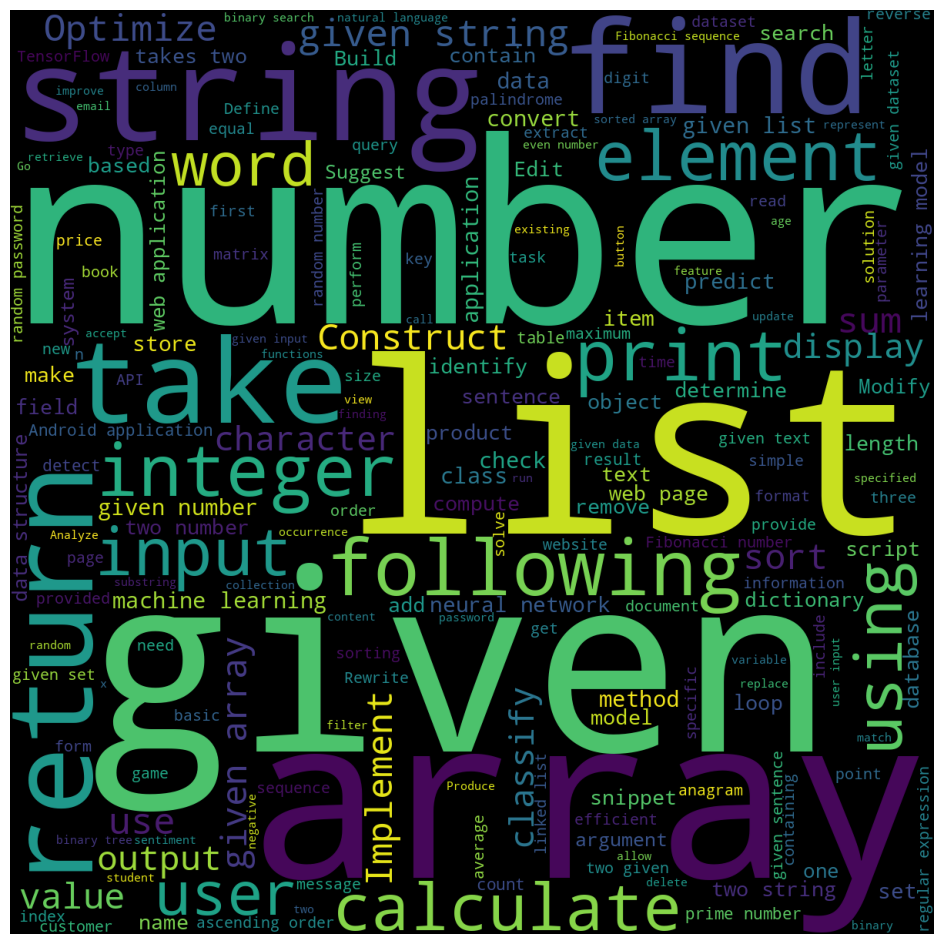

In [7]:
from matplotlib.pyplot import subplots
from matplotlib.pyplot import axis
from matplotlib.pyplot import imshow
from wordcloud import WordCloud

subplots(figsize=(12, 12))
sentences = df['instruction'].values.tolist()
imshow(X=WordCloud(random_state=2023, height=1200, width=1200, stopwords=stopwords,).generate(text = ' '.join(sentences)), )
axis('off')

Our word cloud shows maybe we have removed most of the bland unhelpful words.

In [8]:
from arrow import now
from sentence_transformers import SentenceTransformer
from numpy.linalg import norm

embedding_start = now()
model_name = 'distilbert-base-nli-mean-tokens'
model = SentenceTransformer(model_name_or_path=model_name)
print('{}: max sequence length: {}'.format(now().time(), model.max_seq_length))
print('{}: loaded model: {}'.format(now().time(), model_name))

embedding = model.encode(sentences=sentences, batch_size=64, show_progress_bar=True, convert_to_tensor=True)
# normalize the embeddings
embedding = embedding / norm(embedding, axis=1, keepdims=True)

print('{}: got all embeddings'.format(now().time()))
print('embedding time: {}'.format(now() - embedding_start))

16:57:47.713496: max sequence length: 128
16:57:47.713765: loaded model: distilbert-base-nli-mean-tokens


Batches:   0%|          | 0/391 [00:00<?, ?it/s]

17:05:19.301017: got all embeddings
embedding time: 0:07:36.393304


In [9]:
from arrow import now
from sentence_transformers.util import community_detection
from sklearn.cluster import AgglomerativeClustering

cluster_start = now()
clustering_choices = ['agglomerative', 'community']
clustering = clustering_choices[1]

if clustering == clustering_choices[0]:
    clustering_model = AgglomerativeClustering(n_clusters=None, distance_threshold=1.5) #, affinity='cosine', linkage='average', distance_threshold=0.4)
    clustering_model.fit(X=embedding)
    clusters = clustering_model.labels_
else:
    clusters = community_detection(embeddings=embedding, min_community_size=25, threshold=0.75)

print('cluster time: {}'.format(now() - cluster_start))

cluster time: 0:09:12.897868


In [10]:
from pandas import DataFrame
from plotly.express import scatter
from umap import UMAP
umap_start = now()
init = ['pca', 'random', 'spectral'][0]
umap_model = UMAP(n_components=2, random_state=2023, verbose=1, init=init, n_jobs=1)
umap_df = DataFrame(data=umap_model.fit_transform(X=embedding,), columns=['u0', 'u1',])
umap_df['instruction'] = sentences
cluster = [0] * len(df)
for index, current in enumerate(clusters):
    for row in current:
        cluster[row] = index + 1
umap_df['cluster'] = cluster
print('UMAP time: {}'.format(now() - umap_start))

UMAP(init='pca', n_jobs=1, random_state=2023, verbose=1)
Mon Dec 11 17:15:01 2023 Construct fuzzy simplicial set
Mon Dec 11 17:15:01 2023 Finding Nearest Neighbors
Mon Dec 11 17:15:01 2023 Building RP forest with 13 trees
Mon Dec 11 17:15:09 2023 NN descent for 15 iterations
	 1  /  15
	 2  /  15
	 3  /  15
	 4  /  15
	 5  /  15
	Stopping threshold met -- exiting after 5 iterations
Mon Dec 11 17:15:29 2023 Finished Nearest Neighbor Search
Mon Dec 11 17:15:33 2023 Construct embedding


Epochs completed:   0%|            0/200 [00:00]

	completed  0  /  200 epochs
	completed  20  /  200 epochs
	completed  40  /  200 epochs
	completed  60  /  200 epochs
	completed  80  /  200 epochs
	completed  100  /  200 epochs
	completed  120  /  200 epochs
	completed  140  /  200 epochs
	completed  160  /  200 epochs
	completed  180  /  200 epochs
Mon Dec 11 17:15:54 2023 Finished embedding
UMAP time: 0:00:52.831080


In [11]:
from plotly.express import histogram
histogram(data_frame=umap_df, x='cluster', log_y=True)

In [12]:
scatter(data_frame=umap_df[umap_df['cluster'] == 0], x='u0', y='u1', color='cluster', hover_name='instruction', height=900,
        marginal_x='histogram', marginal_y='histogram', title= 'Cluster Zero (model did not cluster)')

In [13]:
scatter(data_frame=umap_df[umap_df['cluster'] == 1], x='u0', y='u1', color='cluster', hover_name='instruction', height=900,
        marginal_x='histogram', marginal_y='histogram', title= 'Cluster One')

In [14]:
scatter(data_frame=umap_df[umap_df['cluster'] > 1], x='u0', y='u1', color='cluster', hover_name='instruction', height=900,
        marginal_x='histogram', marginal_y='histogram')

In [15]:
scatter(data_frame=umap_df, x='u0', y='u1', color='cluster', hover_name='instruction', height=900)

In [16]:
from plotly.express import scatter
from plotly.express.colors import qualitative

from pandas import DataFrame
def plot_all_terms(input_df: DataFrame, terms: list):
    work_df = input_df.copy()
    work_df['found'] = work_df['instruction'].apply(func=lambda x: '/'.join([term for term in terms if term.lower() in x.lower()]))
    work_df['found'] = work_df['found'].apply(func=lambda x: 'none' if x == '' else x)
    scatter(data_frame=work_df, x='u0', y='u1', color='found', hover_name='instruction', color_discrete_sequence=qualitative.Alphabet,
           ).show()

plot_all_terms(input_df=umap_df, terms=['3', 'three', 'third', '3x3', '3d',])

In [17]:
plot_all_terms(input_df=umap_df, terms=['string', 'android',])

In [18]:
plot_all_terms(input_df=umap_df, terms=['Fibonacci', 'tree', 'password'])

In [19]:
plot_all_terms(input_df=umap_df, terms=['bubble', 'sort', 'quicksort', 'splitsort'])

In [20]:
plot_all_terms(input_df=umap_df, terms=['handwritten', 'digit'])

In [21]:
plot_all_terms(input_df=umap_df, terms=['genetic', 'algorithm'])

In [22]:
plot_all_terms(input_df=umap_df, terms=['dimension', 'dimensional', 'two', 'three'])

In [23]:
plot_all_terms(input_df=umap_df, terms=['sql', 'mongodb'])

In [24]:
plot_all_terms(input_df=umap_df, terms=['mongodb', 'mongoose', 'database'])

In [25]:
plot_all_terms(input_df=umap_df, terms=['database',])

In [26]:
plot_all_terms(input_df=umap_df, terms=['schema',])

In [27]:
plot_all_terms(input_df=umap_df, terms=['neural', 'network', 'machine', 'learning', 'genetic'])

In [28]:
plot_all_terms(input_df=umap_df, terms=['develop', 'create', 'design'])

In [29]:
plot_all_terms(input_df=umap_df, terms=['0', '1', '2', '3', '4', '5', '6', '7', '8', '9'])